In [1]:
import numpy as np
import tensorflow as tf
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
import csv
import matplotlib.pyplot as plt

<p> Terdapat 427729 Kalimat yang akan digunakan sebagai tokenizer untuk train model kita nanti</p>

# Function Load Dataset

In [6]:
def load_dataset(filename):
    sentences = []
    labels = []

    with open(filename, "r") as file:
        reader = csv.reader(file, delimiter=",")
        next(reader)
        for row in reader:
            sentences.append(row[0])
            labels.append(int(row[1]))

    return sentences, labels

# Load Dataset From CSV

In [7]:
csvDataset = "./DatasetCSV/Dataset_fix.csv"
csvValidation = "./DatasetCSV/Validation_Dataset.csv"

train_sentences , train_labels = load_dataset(csvDataset)
validation_sentences, validation_labels = load_dataset(csvValidation)


In [8]:
print(len(train_sentences))
#sample
print(train_sentences[0])
print(train_sentences[1500])
print(train_labels[120])


1636
lantai, sapu pel permukaan teratur.
membantu kepindahan tinggal berbeda?
0


Setting Utiliti Untuk Knobs

In [9]:
vocab_size = 1000
oov = "<OOV>"
padding = "post"
truncate = "post"
embedding_dim = 16
max_length = 25

# Set Up Tokenizer

In [10]:
#set Tokenizer
tokenizer = Tokenizer(num_words=vocab_size, oov_token=oov)
#Fit on texts get the word index
tokenizer.fit_on_texts(sentences)

print(tokenizer.word_index)

{'<OOV>': 1, 'kategori': 2, 'the': 3, 'of': 4, 'referensi': 5, 'indonesia': 6, 'film': 7, 'orang': 8, 'kota': 9, 'memiliki': 10, 'spesies': 11, 'pranala': 12, 'and': 13, 'nama': 14, 'bahasa': 15, 'negara': 16, 'amerika': 17, 'desa': 18, 'in': 19, 'asteroid': 20, 'tanggal': 21, 'dunia': 22, 'wilayah': 23, 'selatan': 24, 'kayu': 25, 'salah': 26, 'barat': 27, 'lagu': 28, 'kabupaten': 29, 'kelas': 30, 'anak': 31, 'px': 32, 'serikat': 33, 'timur': 34, 'anggota': 35, 'daerah': 36, 'september': 37, 'utara': 38, 'de': 39, 'mei': 40, 'daftar': 41, 'jepang': 42, 'cerambycidae': 43, 'kali': 44, 'air': 45, 'raja': 46, 'utama': 47, 'hidup': 48, 'album': 49, 'negeri': 50, 'inggris': 51, 'genus': 52, 'ordo': 53, 'kumbang': 54, 'lalat': 55, 'sekolah': 56, 'jpg': 57, 'berkas': 58, 'sejarah': 59, 'perang': 60, 'pulau': 61, 'nasional': 62, 'jawa': 63, 'rumah': 64, 'dikenal': 65, 'kecamatan': 66, 'tim': 67, 'al': 68, 'an': 69, 'tokoh': 70, 'famili': 71, 'kingdom': 72, 'ii': 73, 'terletak': 74, 'pendidikan

# Sequences The dataset

In [11]:
train_sequences = tokenizer.texts_to_sequences(train_sentences)
train_padded = pad_sequences(train_sequences, padding=padding, maxlen=max_length, truncating=truncate)

validation_sequences = tokenizer.texts_to_sequences(validation_sentences)
validation_padded = pad_sequences(validation_sequences, padding=padding, maxlen=max_length, truncating=truncate)

train_labels=np.array(train_labels)
validation_labels=np.array(validation_labels)
train_labels = np.expand_dims(train_labels, axis=1)
validation_labels = np.expand_dims(validation_labels, axis=1)

In [12]:
print(train_padded.shape)
print(validation_padded.shape)
print(train_labels.shape)
print(validation_labels.shape)
print(train_labels)

(1636, 25)
(258, 25)
(1636, 1)
(258, 1)
[[0]
 [0]
 [0]
 ...
 [4]
 [4]
 [4]]


# Creating The model and Tuning The model

In [13]:
model = tf.keras.Sequential([
        tf.keras.layers.Embedding(vocab_size, embedding_dim, input_length=max_length),
        tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64,return_sequences=True)),
        tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32)),
        tf.keras.layers.Flatten(),
        #tf.keras.layers.GlobalAveragePooling1D(),
        tf.keras.layers.Dense(128, activation='relu'),
        tf.keras.layers.Dropout(0.2),
        tf.keras.layers.Dense(64, activation='relu'),
        #tf.keras.layers.Dropout(0.3),
        tf.keras.layers.Dense(5, activation='softmax')
    ])
model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(), optimizer='adam',metrics=['accuracy'])
model.summary()



Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 25, 16)            16000     
                                                                 
 bidirectional (Bidirection  (None, 25, 128)           41472     
 al)                                                             
                                                                 
 bidirectional_1 (Bidirecti  (None, 64)                41216     
 onal)                                                           
                                                                 
 flatten (Flatten)           (None, 64)                0         
                                                                 
 dense (Dense)               (None, 128)               8320      
                                                                 
 dropout (Dropout)           (None, 128)              

#Train The model

In [16]:
history = model.fit(train_padded, train_labels,epochs=30, validation_data=(validation_padded, validation_labels))

Epoch 1/30
52/52 [==============================] - 1s 26ms/step - loss: 0.4903 - accuracy: 0.7830 - val_loss: 1.8789 - val_accuracy: 0.4574
Epoch 2/30
52/52 [==============================] - 1s 12ms/step - loss: 0.4821 - accuracy: 0.7934 - val_loss: 1.8276 - val_accuracy: 0.4109
Epoch 3/30
52/52 [==============================] - 1s 12ms/step - loss: 0.4770 - accuracy: 0.7855 - val_loss: 1.8867 - val_accuracy: 0.4806
Epoch 4/30
52/52 [==============================] - 1s 12ms/step - loss: 0.4841 - accuracy: 0.7989 - val_loss: 2.0994 - val_accuracy: 0.4690
Epoch 5/30
52/52 [==============================] - 1s 12ms/step - loss: 0.4629 - accuracy: 0.7965 - val_loss: 1.9825 - val_accuracy: 0.4341
Epoch 6/30
52/52 [==============================] - 1s 12ms/step - loss: 0.4605 - accuracy: 0.8068 - val_loss: 2.0639 - val_accuracy: 0.4574
Epoch 7/30
52/52 [==============================] - 1s 13ms/step - loss: 0.4635 - accuracy: 0.7971 - val_loss: 1.7698 - val_accuracy: 0.5000
Epoch 8/30
52

# Plot The Accuracy and validation

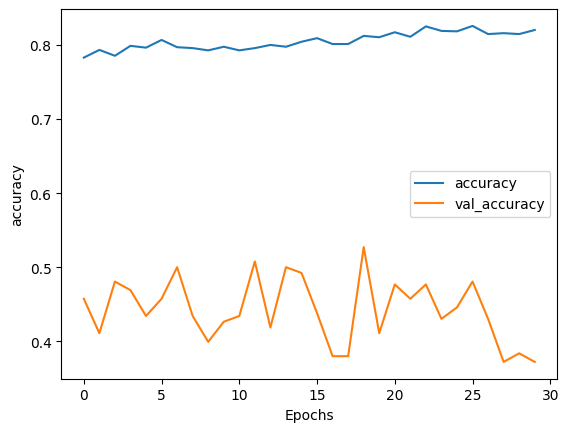

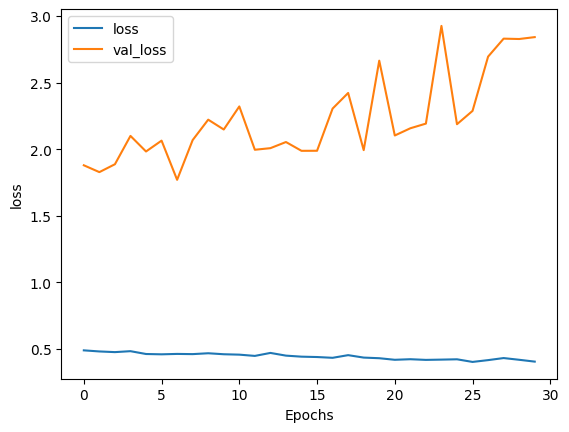

In [17]:
def plot_graphs(history, metric):
    plt.plot(history.history[metric])
    plt.plot(history.history[f'val_{metric}'])
    plt.xlabel("Epochs")
    plt.ylabel(metric)
    plt.legend([metric, f'val_{metric}'])
    plt.show()
    
plot_graphs(history, "accuracy")
plot_graphs(history, "loss")

# Test Predict Job Categorazation